In [1]:
from keras.models import load_model
model=load_model('cats_and_dogs_small_2.h5')
print(model.summary())

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 74, 74, 32)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 17, 17, 128)     

In [6]:
img_path=r"C:\Users\skuma\OneDrive\Desktop\ML\DogsVsCat_data\test\cats\1700.jpg"
from tensorflow.keras.utils import load_img, img_to_array, array_to_img
import numpy as np
img=load_img(img_path,target_size=(150,150))
print("Image: ",img)
img_tensor=img_to_array(img)
img_tensor=np.expand_dims(img_tensor,axis=0)
img_tensor/=255.

print(img_tensor.shape)

Image:  <PIL.Image.Image image mode=RGB size=150x150 at 0x1DA8A4D1810>
(1, 150, 150, 3)


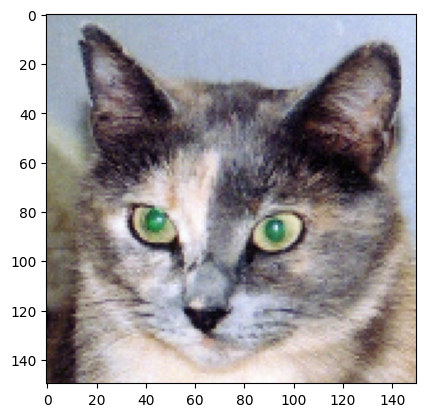

In [7]:
import matplotlib.pyplot as plt

plt.imshow(img_tensor[0])
plt.show()

In [ ]:
from keras import models
#extract the output of 8 layer
layer_outputs=[layer.output for layer in model.layers[:8]]
#creates a model that will return the output s given the model input
activation_model=models.Model(inputs=model.input,outputs=layer_outputs)
#running the model in predict mode
activations=activation_model.predict(img_tensor)#returns a list of 8 Numpy arrays:one array per layer activation
print(len(activations))

1/1 [==============================] - 118s 118s/step
8


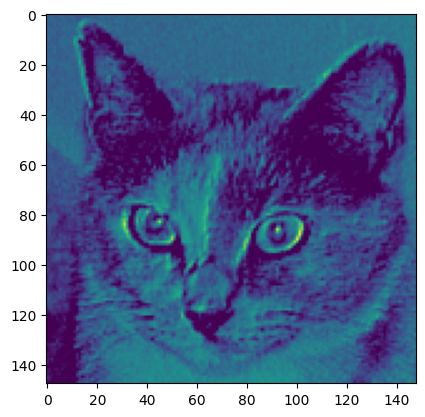

In [25]:
layer_activation=activations[0]
plt.imshow(layer_activation[0,:,:,7],cmap='viridis')

C:\Users\skuma\AppData\Local\Temp\ipykernel_17260\246905913.py:19: RuntimeWarning: invalid value encountered in cast
  channel_image = np.clip(channel_image, 0, 255).astype('uint8')


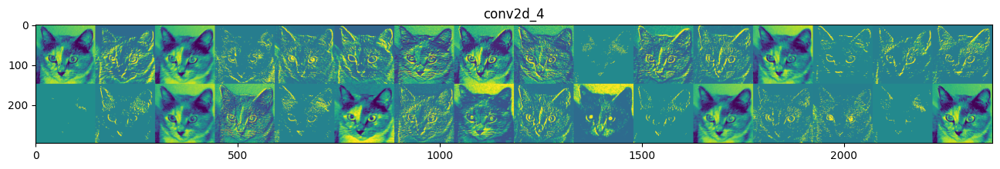

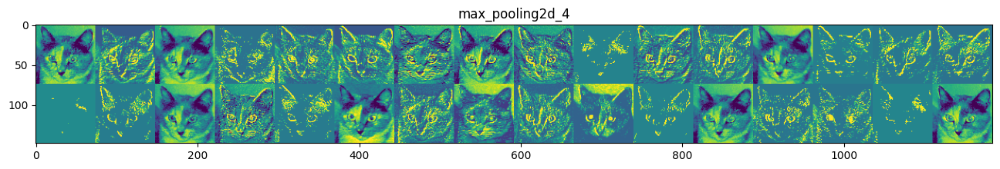

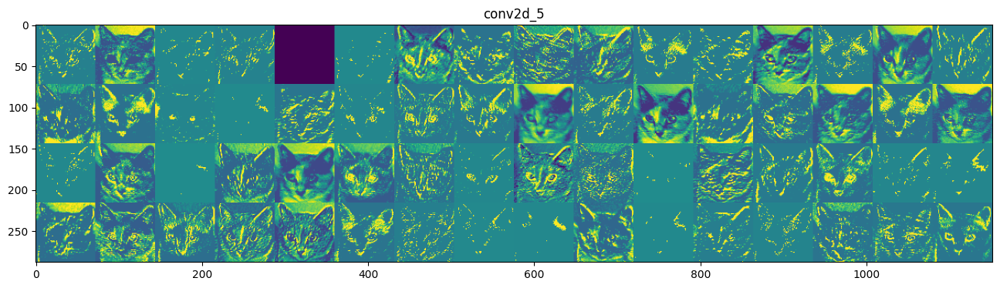

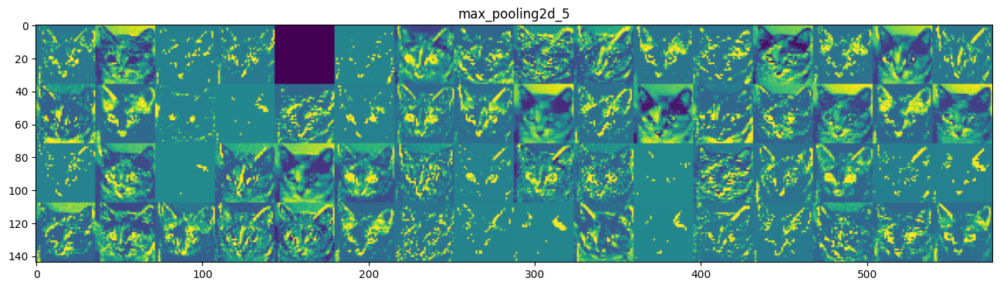

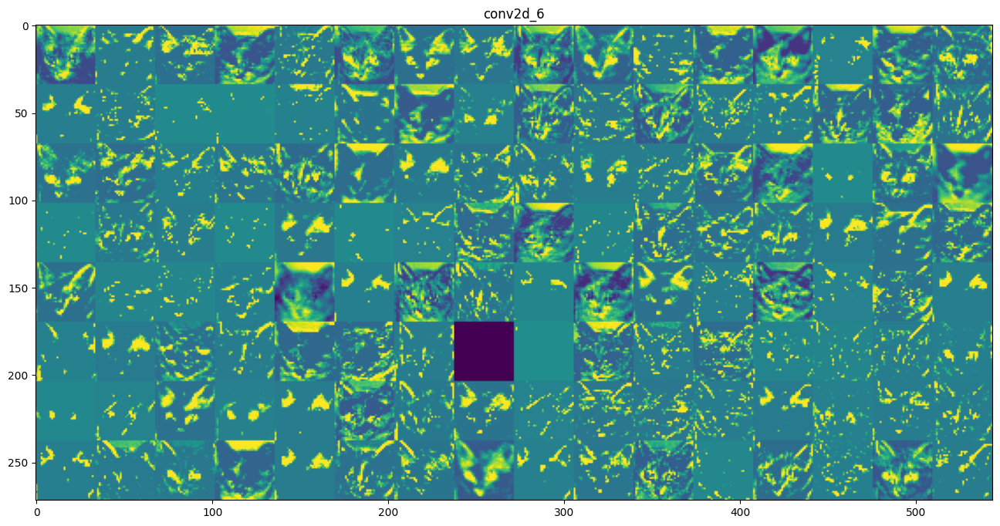

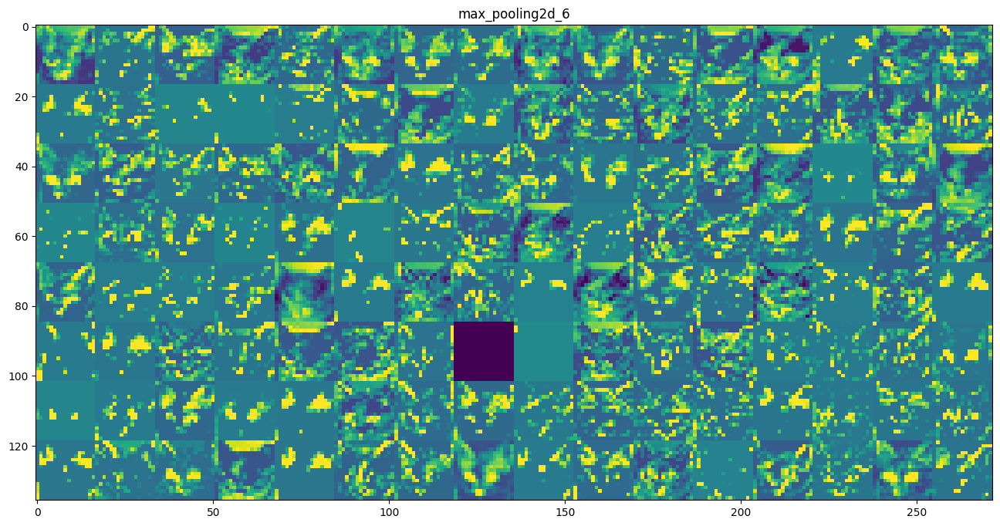

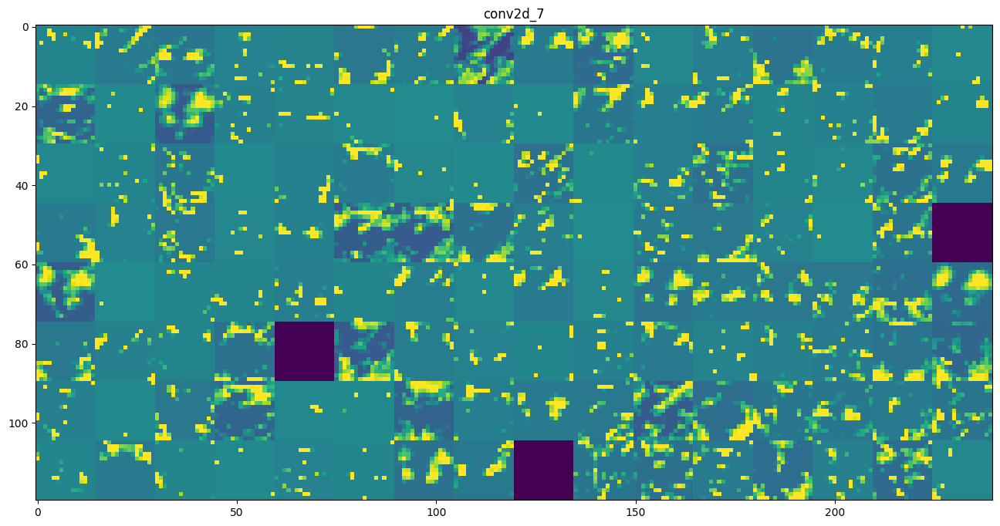

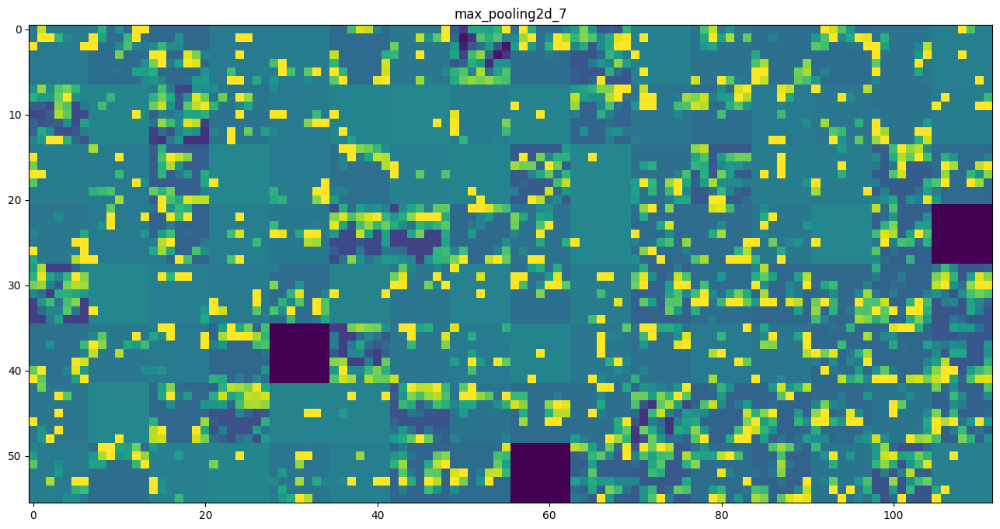

In [27]:
layer_names=[]
for layer in model.layers[:8]:
    layer_names.append(layer.name)
images_per_row = 16
for layer_name, layer_activation in zip(layer_names, activations):
    n_features = layer_activation.shape[-1]
    size = layer_activation.shape[1]
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,:, :,col * images_per_row + row] 
            mn=channel_image.mean()
            sd= channel_image.std()
            channel_image-= mn
            channel_image /= sd
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],scale * display_grid.shape[0]))    
    plt.grid(False)
    plt.title(layer_name)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    

In [ ]:
#visualizing convnet filters
#defining the loss tensor for filter visualization
from keras.applications import VGG16
import tensorflow as tf

# model that outputs the target layer activations
model=VGG16(weights='imagenet',
            include_top=False
            )



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
def deprocess_image(x):
    x-=x.mean()
    x/=(x.std()+1e-1)
    x*=0.1
    
    x+=0.5
    x=np.clip(x,0,1).astype(np.float32)
    
    #converts to an RGB array
    x*=255
    x=np.clip(x,0,255).astype(np.uint8)
    return x
def generate_pattern(layer_name,filter_index,size=150):
    input_img_data=np.random.random((1,size,size,3))*256
    input_img=tf.Variable(input_img_data,dtype=tf.float32)
    #obtaining the gradient of the loss with regard to the input
    steps=40
    step_size=1.0
    # build a submodel that returns that layer's activations
    filter_index=0
    submodel = tf.keras.Model(inputs=model.input,
                            outputs=model.get_layer(layer_name).output)
    #loss maximization via stochastic gradient descent
    for i in range(steps):
        with tf.GradientTape() as tape:
            tape.watch(input_img)
            activations=submodel(input_img)
            #rint(activations.shape)
            loss=tf.reduce_mean(activations[..., filter_index])
        grads=tape.gradient(loss,input_img)
        #Gradient-normalization trich (dividing by its L2 Norm)
        grads/=(tf.sqrt(tf.reduce_mean(tf.square(grads)))+1e-5)
        input_img.assign_add(grads*step_size)
    return deprocess_image(input_img.numpy()[0])

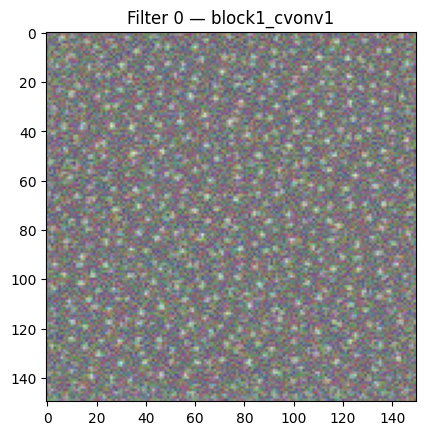

In [86]:
#plotting
img=generate_pattern('block3_conv1',0)
plt.imshow(img)
plt.title(f'Filter {0} — {layer_name}')

plt.show()

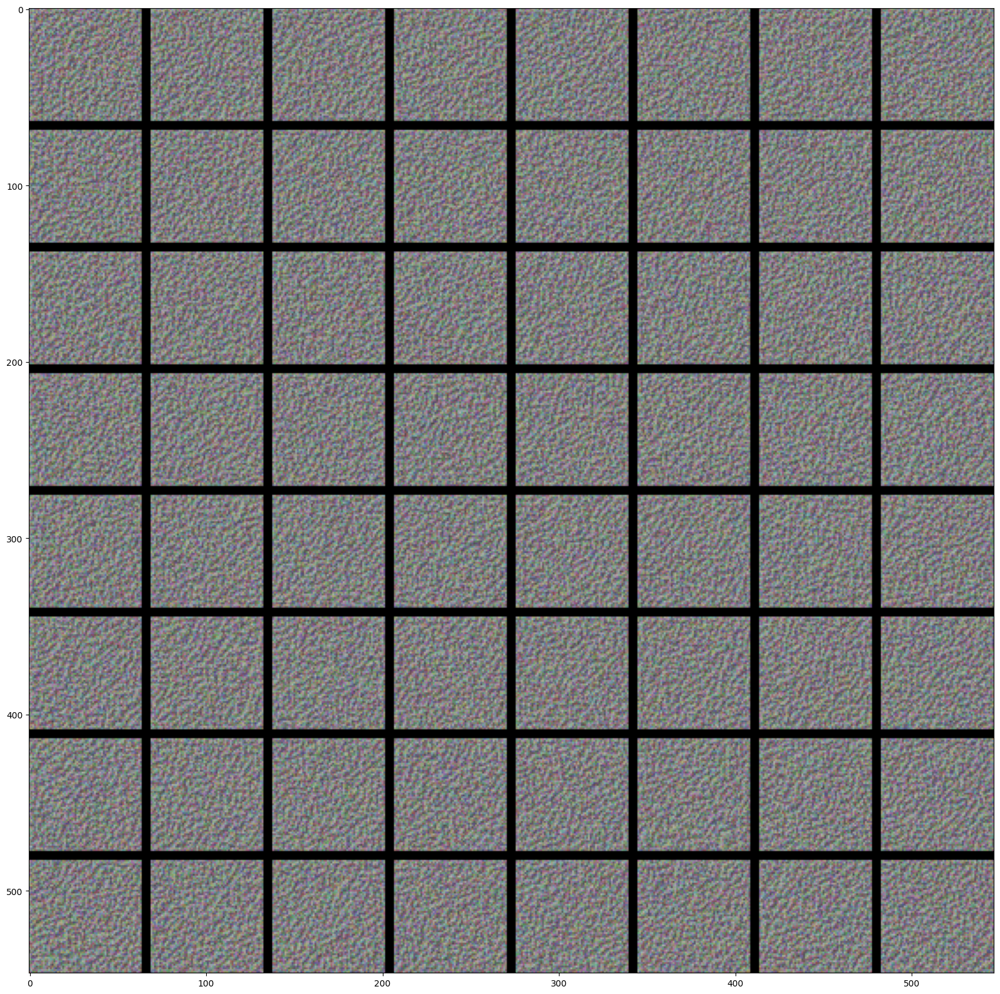

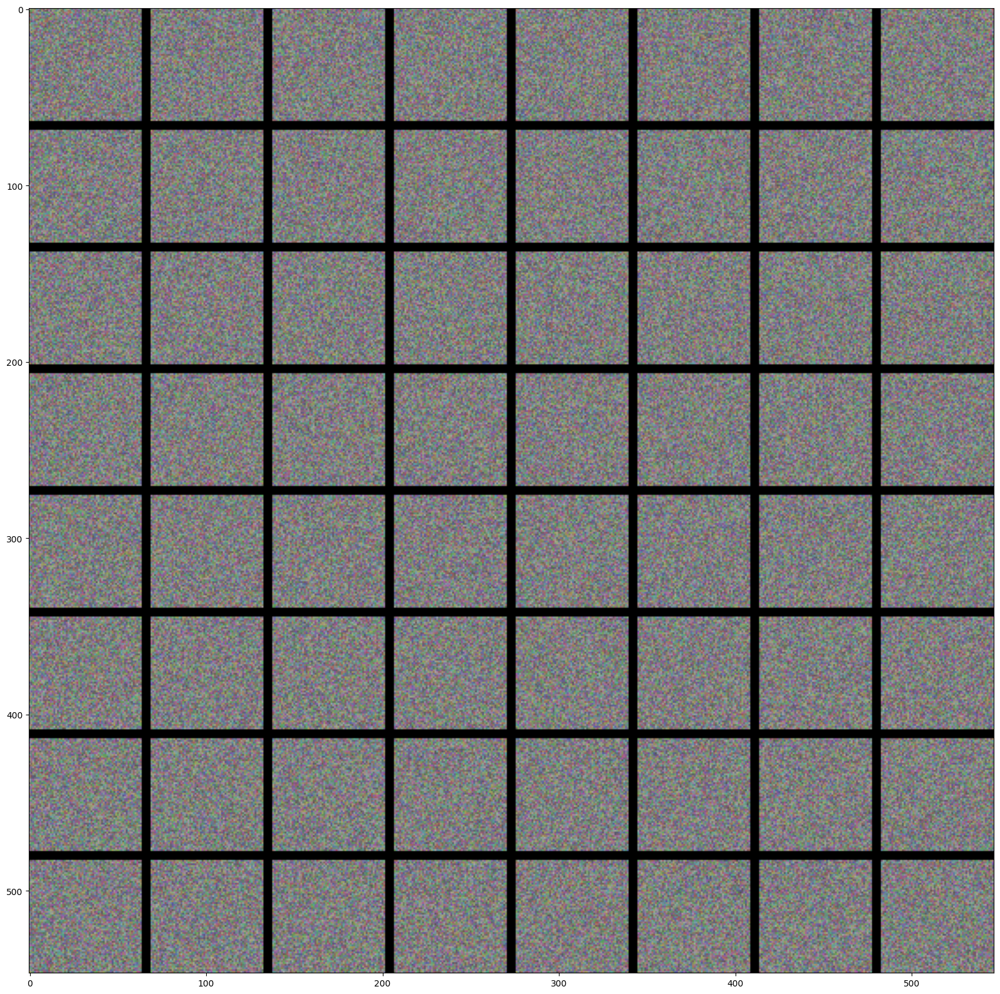

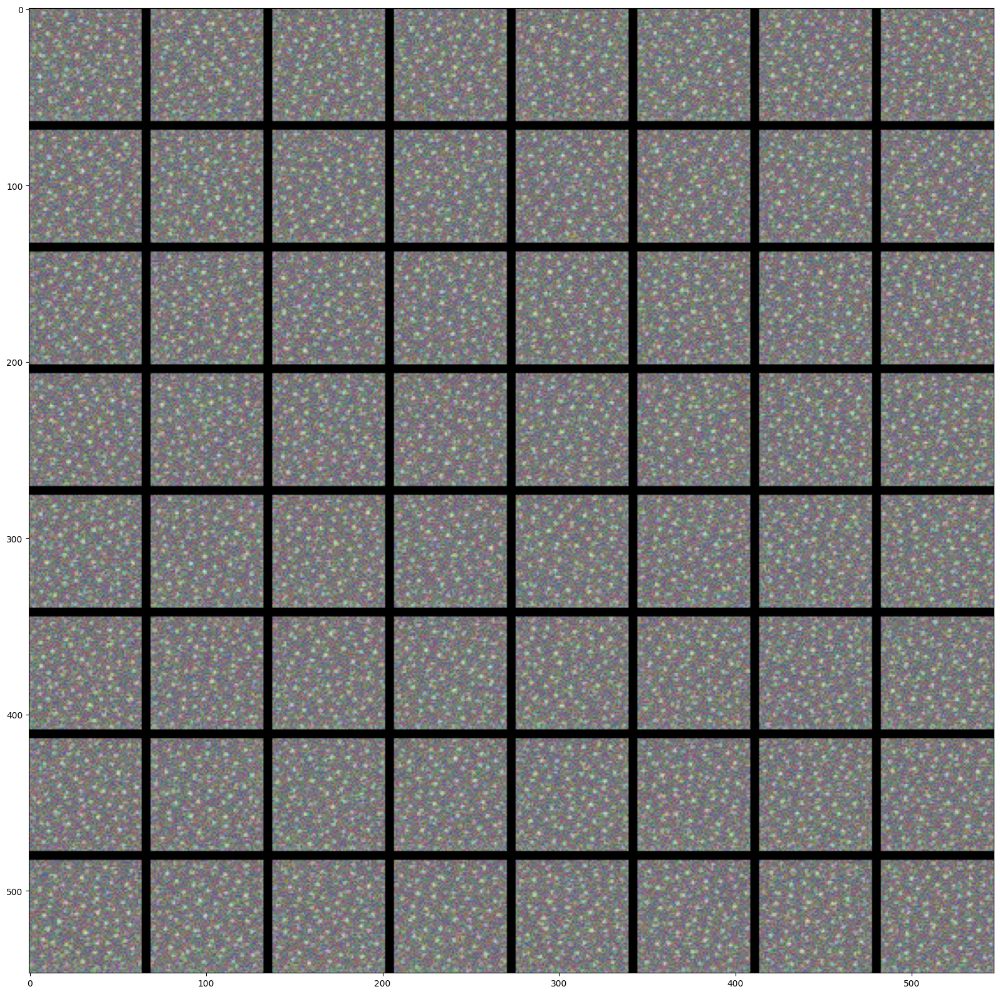

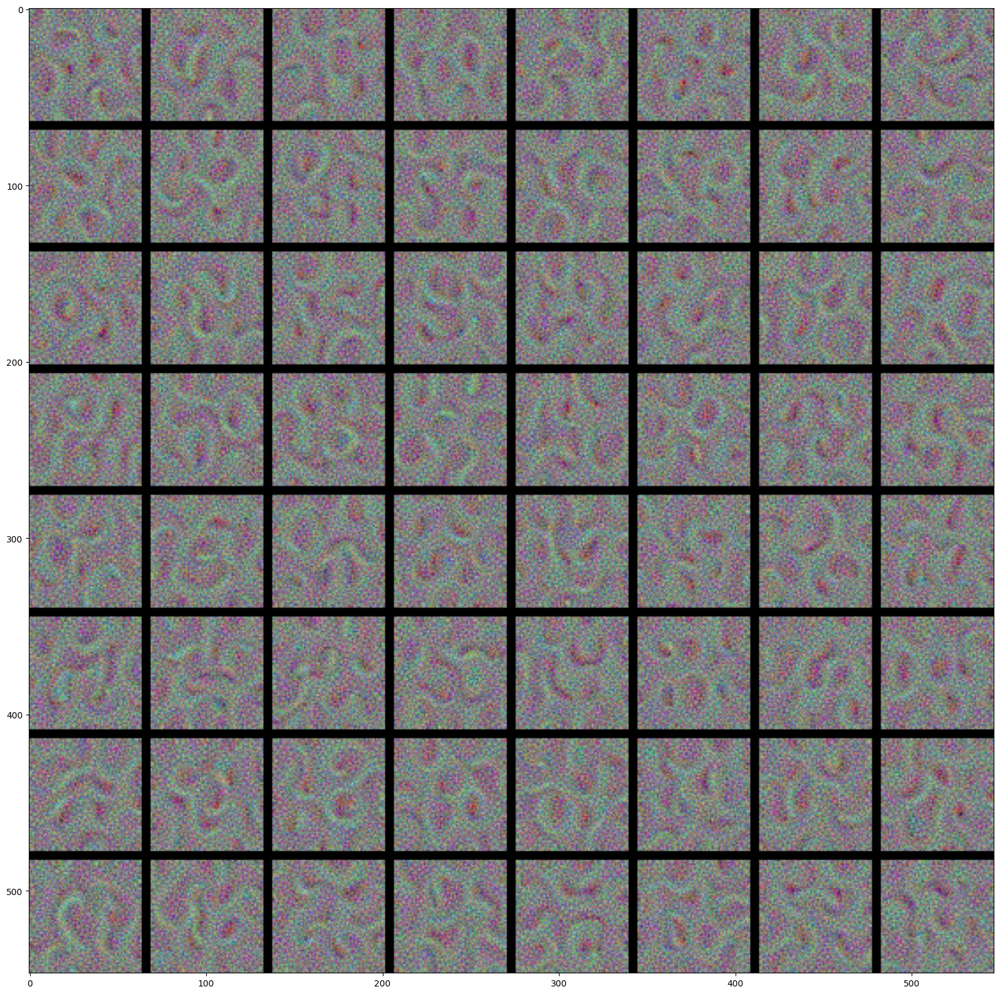

In [87]:
#generating a grid of all filter response patterns in a layer
layer_name='block1_cvonv1'
size=64
margin=5
for block in range(1,5):
    results=np.zeros((8*size+7*margin,8*size+7*margin,3)).astype(np.uint8)
    for i in range(8):
        for j in range(8):
            filter_img=generate_pattern(f'block{block}_conv1',i*8+j,size)
            horizontal_start=i*size+i*margin
            horizontal_end=horizontal_start+size
            vertical_start=j*size+j*margin
            vertical_end=vertical_start+size
            results[horizontal_start:horizontal_end,vertical_start:vertical_end]=filter_img

    #display the results
    plt.figure(figsize=(20,20))
    plt.imshow(results)
        
        

In [88]:
#visualizing the heatmaps of class activation
from keras.applications.vgg16 import VGG16
model3=VGG16(weights='imagenet')

553467096/553467096 [==============================] - 255s 0us/step


In [89]:
from tensorflow.keras.utils import load_img,img_to_array
from keras.applications.vgg16 import preprocess_input,decode_predictions

img_path=r'C:\Users\skuma\OneDrive\Desktop\ML\fox.jpg'
img=load_img(img_path,target_size=(224,224))
x=img_to_array(img)
x=np.expand_dims(x,axis=0)
x=preprocess_input(x)

In [90]:
preds=model3.predict(x)
print('Predicted:',decode_predictions(preds,top=3)[0])


35363/35363 [==============================] - 0s 5us/step
Predicted: [('n02119022', 'red_fox', 0.6835066), ('n02119789', 'kit_fox', 0.30372682), ('n02120505', 'grey_fox', 0.011741308)]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-123.68..151.061].


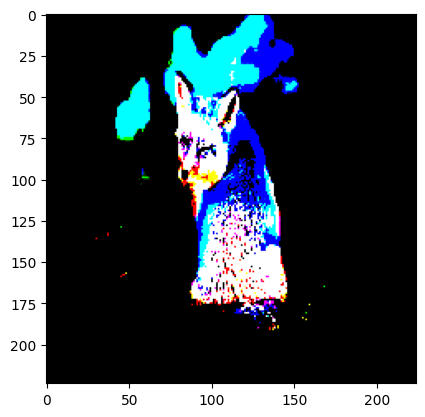

In [94]:
plt.imshow(x[0])

In [91]:
print(model3.summary())

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [92]:
print(np.argmax(preds[0]))

277


(1, 14, 14, 512)


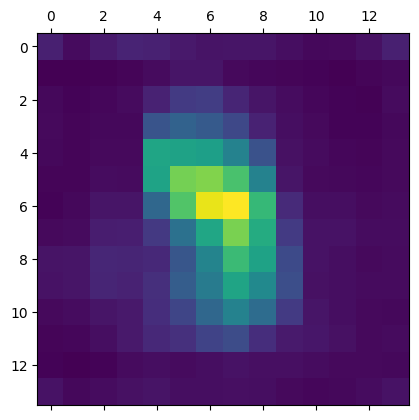

In [ ]:
#to visualize which part of the image are most fox like structure
last_conv_layer = model3.get_layer('block5_conv3')

#a model that give listed ouput on passing given input
grad_model = tf.keras.models.Model(
    [model3.inputs],
    [last_conv_layer.output, model3.output]
)

with tf.GradientTape() as tape:
    conv_outputs, predictions = grad_model(x)
    red_fox_output = predictions[:, 277]   # class index

grads = tape.gradient(red_fox_output, conv_outputs)
pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
print(conv_outputs.shape)
conv_outputs = conv_outputs[0]

heatmap=tf.reduce_sum(conv_outputs*pooled_grads,axis=-1)
heatmap=np.mean(conv_outputs,axis=-1)
heatmap=np.maximum(heatmap,0)
heatmap/=np.max(heatmap)
plt.matshow(heatmap)


In [106]:
print(grads.shape)
print(heatmap.shape)
print(conv_outputs.shape)
print(last_conv_layer)

(1, 14, 14, 512)
(14, 14)
(14, 14, 512)


In [123]:
#superimposing the heatmap with the original picture
import cv2
img=cv2.imread(img_path)
heatmap=np.resize(heatmap,(img.shape[0],img.shape[1]))
heatmap=np.uint8(255*heatmap)
heatmap=cv2.applyColorMap(heatmap,cv2.COLORMAP_JET)
superimposed_img=heatmap*0.4 +img
cv2.imwrite(r'C:\Users\skuma\OneDrive\Desktop\ML\fox2.jpg',superimposed_img)

True